In [32]:
import astropy.constants as c
from astropy.io import fits
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

#from special.model_resampling import resample_model
#from special.utils_spec import find_nearest

from vip_hci.config import VLT_SPHERE_IFS
from vip_hci.fits import open_fits, write_fits, info_fits
from vip_hci.fm import (cube_inject_companions, firstguess, mcmc_negfc_sampling, normalize_psf,
                        show_walk_plot, show_corner_plot, confidence)
from vip_hci.metrics import snr, significance
from vip_hci.psfsub import median_sub, pca, pca_annular, pca_annulus, pca_grid
from vip_hci.preproc import find_scal_vector, frame_rescaling
from vip_hci.var import frame_center, dist, mask_circle

## Loading and visualizing the data

In [5]:
# Let’s first inspect the fits file
info_fits('/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits')

Filename: /home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  SCIDATA       1 PrimaryHDU    1271   (290, 290, 24, 39)   float32   


In [6]:
cubename = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits'
psfname = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_PSF_MASTER_CUBE-median_unsat.fits'
lbdaname = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_LAMBDA_INFO-lam.fits'
anglename = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_PARA_ROTATION_CUBE-rotnth.fits'

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
derot_angles = -1*open_fits(anglename) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input

nch, nz, ny, nx = cube.shape

Fits HDU-0 data successfully loaded. Data shape: (39, 24, 290, 290)
Fits HDU-0 data successfully loaded. Data shape: (39, 2, 64, 64)
Fits HDU-0 data successfully loaded. Data shape: (39,)
Fits HDU-0 data successfully loaded. Data shape: (24,)


In [34]:
cubee = fits.open('/home/cvargas/sphere/IFS/SPHERE_DC_DATA_HD143006_IFS/HD-143006_OBS_H_2021-04-03_ifs_convert_dc2_PUBLIC_305426/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits')

In [36]:
cubee[0].header

SIMPLE  =                    T / Written by IDL:  Mon Jan 17 21:14:41 2022      
BITPIX  =                  -32 / IEEE single precision floating point           
NAXIS   =                    4 / number of data axes                            
NAXIS1  =                  290 /Number of positions along axis 1                
NAXIS2  =                  290 /Number of positions along axis 2                
NAXIS3  =                   24 /Number of positions along axis 3                
NAXIS4  =                   39 /Number of positions along axis 4                
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
DATE    = '2022-01-17T14:24:11' / file creation date (YYYY-MM-DDThh:mm:ss UT)   
HDUCLASS= 'ESO     '                                                            
HDUDOC  = 'DICD    '        

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[290, 290, 24, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
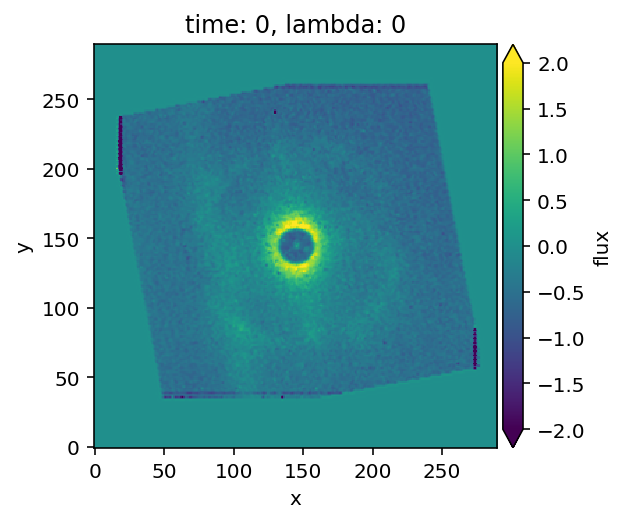

In [7]:
plot_cubes(cube, vmin=-2, vmax=2)

Text(0, 0.5, 'Parallactic angle (deg)')

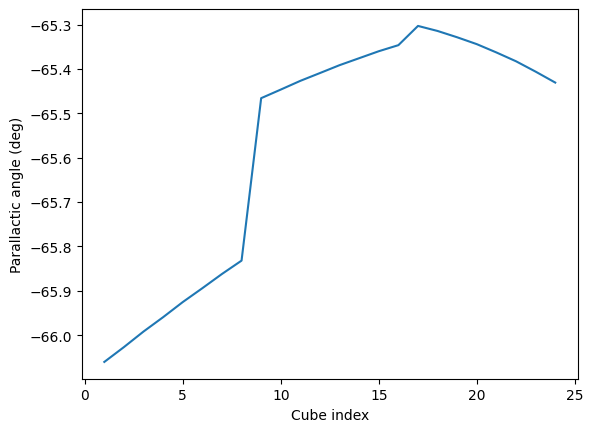

In [8]:
%matplotlib inline
fig, axes = plt.subplots(1)
ax1 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")

In [9]:
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


## Flux normalization

### Non-coronagraphic PSF normalization

`Force_odd` is True and frame size is even, therefore new frame size was set to 63


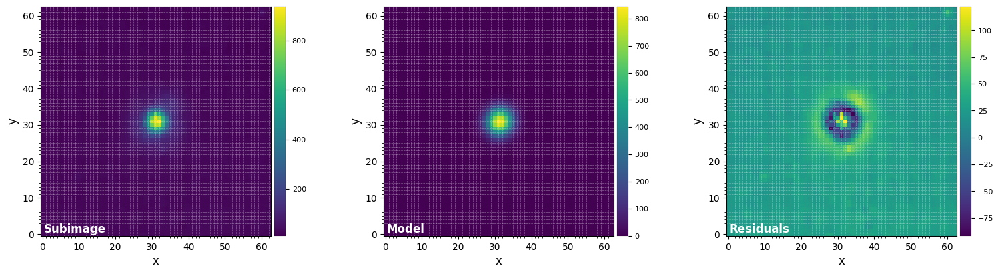

FWHM_y = 6.074277999028801
FWHM_x = 5.764795807826017 

centroid y = 30.918002686421886
centroid x = 31.273091652094372
centroid y subim = 30.918002686421886
centroid x subim = 31.273091652094372 

amplitude = 850.0091267160898
theta = -27.156917960870945


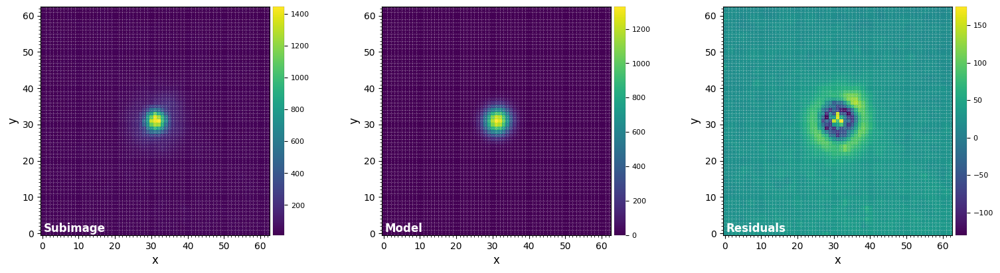

FWHM_y = 5.862129307114519
FWHM_x = 5.57319308817715 

centroid y = 31.034869027818267
centroid x = 31.247858658060917
centroid y subim = 31.034869027818267
centroid x subim = 31.247858658060917 

amplitude = 1337.1898522545596
theta = -23.19440734695102


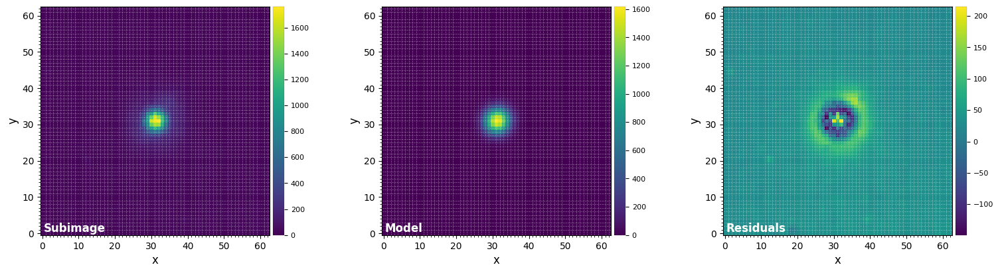

FWHM_y = 5.526300017263042
FWHM_x = 5.78264518826876 

centroid y = 31.01870391406352
centroid x = 31.247178646404468
centroid y subim = 31.01870391406352
centroid x subim = 31.247178646404468 

amplitude = 1627.3922155663515
theta = -122.28889088373155


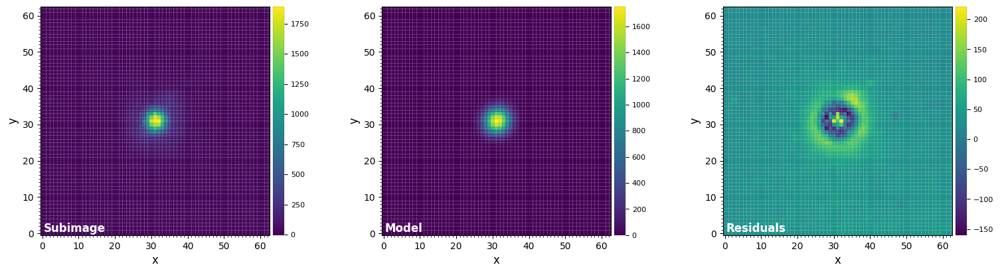

FWHM_y = 5.795875216043999
FWHM_x = 5.496610279076191 

centroid y = 31.027302441878277
centroid x = 31.230974209783387
centroid y subim = 31.027302441878277
centroid x subim = 31.230974209783387 

amplitude = 1761.254063492559
theta = 321.90420495911246


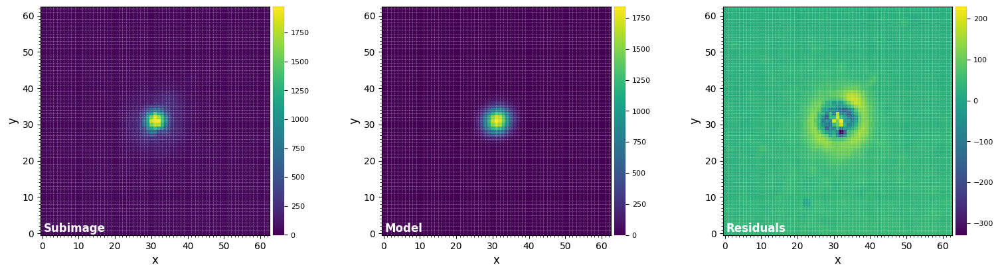

FWHM_y = 5.408182618243864
FWHM_x = 5.854298528787686 

centroid y = 31.062803565725883
centroid x = 31.20015307713993
centroid y subim = 31.062803565725883
centroid x subim = 31.20015307713993 

amplitude = 1847.8271021820399
theta = 38.3292052875964


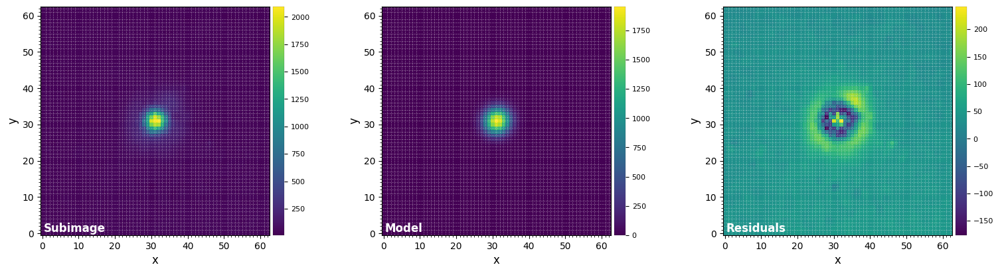

FWHM_y = 5.568948960047836
FWHM_x = 5.818647616832941 

centroid y = 31.00225860743554
centroid x = 31.185484932448283
centroid y subim = 31.00225860743554
centroid x subim = 31.185484932448283 

amplitude = 1961.8268946500527
theta = 51.80314525144978


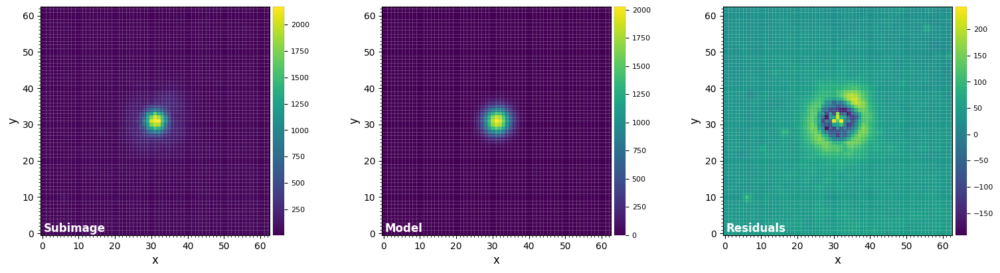

FWHM_y = 5.696097848399996
FWHM_x = 5.913825737169806 

centroid y = 30.961492775883347
centroid x = 31.195437898707983
centroid y subim = 30.961492775883347
centroid x subim = 31.195437898707983 

amplitude = 2035.5112500983992
theta = -298.51034562144105


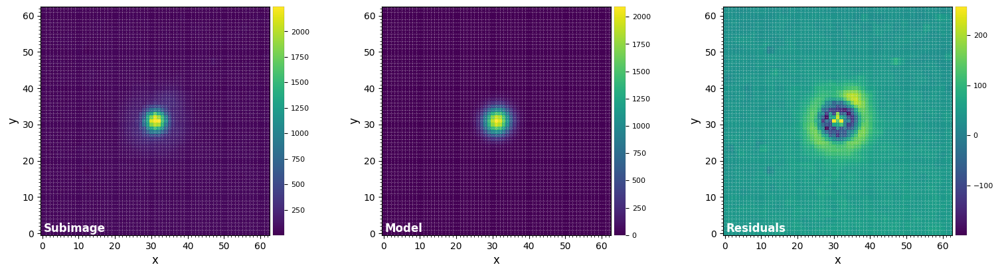

FWHM_y = 6.005044893249133
FWHM_x = 5.742301102866178 

centroid y = 30.973466776009825
centroid x = 31.18411317834392
centroid y subim = 30.973466776009825
centroid x subim = 31.18411317834392 

amplitude = 2099.198530136108
theta = -211.91372550037346


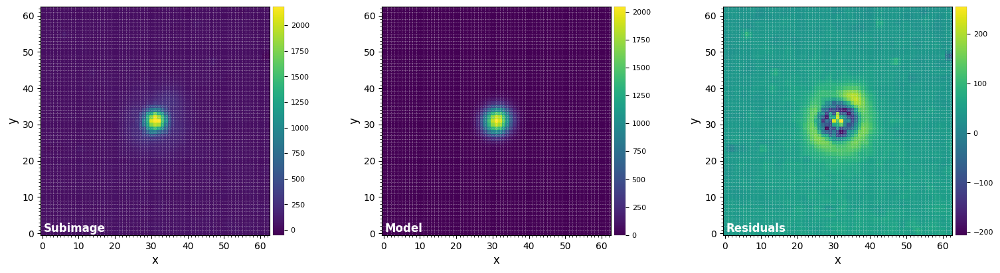

FWHM_y = 6.007565450187758
FWHM_x = 5.706070972411801 

centroid y = 31.04917202324171
centroid x = 31.142027942557583
centroid y subim = 31.04917202324171
centroid x subim = 31.142027942557583 

amplitude = 2049.4494738986477
theta = 141.18214818892966


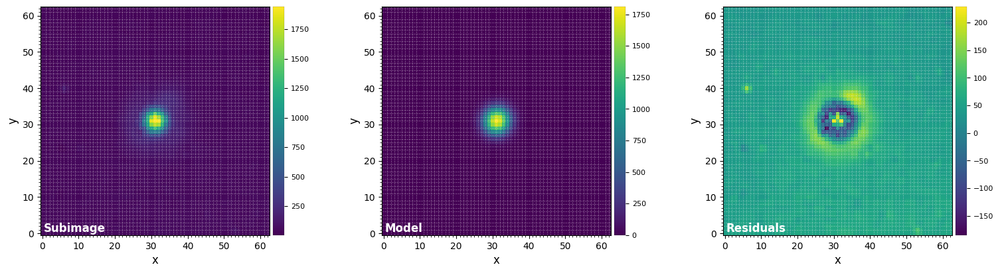

FWHM_y = 6.083646594008253
FWHM_x = 5.830824915218121 

centroid y = 31.02659214794605
centroid x = 31.148724820577016
centroid y subim = 31.02659214794605
centroid x subim = 31.148724820577016 

amplitude = 1815.51563668178
theta = 152.28177770708263


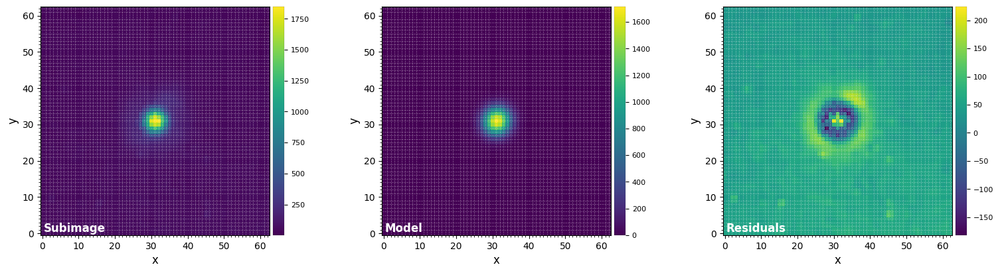

FWHM_y = 6.225747265058466
FWHM_x = 5.914722515757052 

centroid y = 30.964496444428057
centroid x = 31.143622694130325
centroid y subim = 30.964496444428057
centroid x subim = 31.143622694130325 

amplitude = 1719.6798719951935
theta = 332.9581558253286


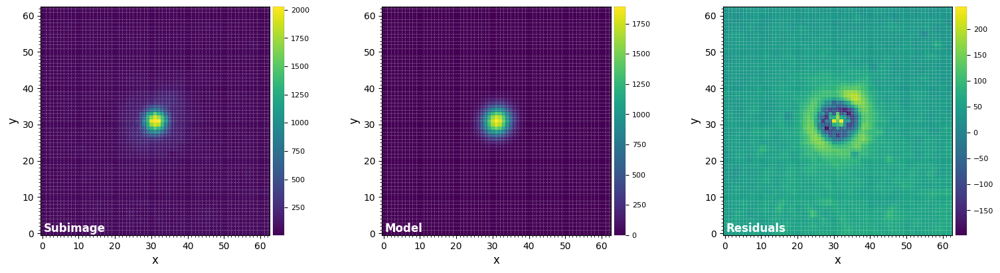

FWHM_y = 6.306875629399145
FWHM_x = 5.927550337152104 

centroid y = 30.93163431155696
centroid x = 31.119527966533127
centroid y subim = 30.93163431155696
centroid x subim = 31.119527966533127 

amplitude = 1894.2896002309185
theta = -210.86530366883608


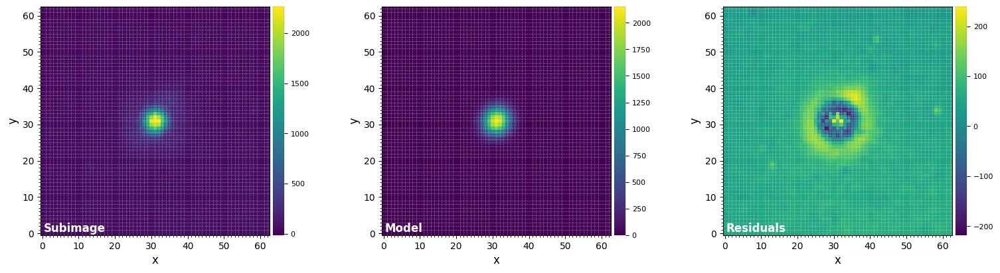

FWHM_y = 6.2986437721022055
FWHM_x = 5.845589159001203 

centroid y = 30.970342649294192
centroid x = 31.09353386093668
centroid y subim = 30.970342649294192
centroid x subim = 31.09353386093668 

amplitude = 2154.831405981249
theta = -30.956787840025992


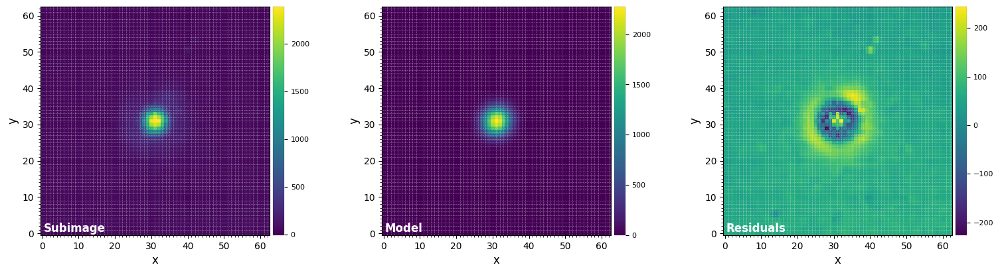

FWHM_y = 6.299770227734011
FWHM_x = 5.941216902376113 

centroid y = 30.9351236265894
centroid x = 31.082068757184434
centroid y subim = 30.9351236265894
centroid x subim = 31.082068757184434 

amplitude = 2278.262482797899
theta = -30.047937709705415


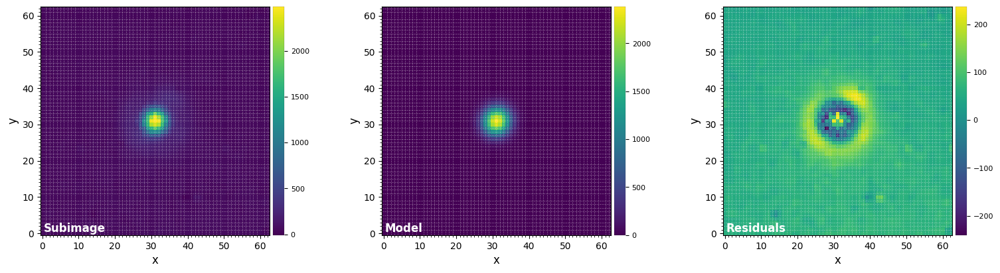

FWHM_y = 6.304853105687292
FWHM_x = 5.9722592261269805 

centroid y = 30.936612594014232
centroid x = 31.06681338125762
centroid y subim = 30.936612594014232
centroid x subim = 31.06681338125762 

amplitude = 2385.705022016643
theta = -25.990540539093345


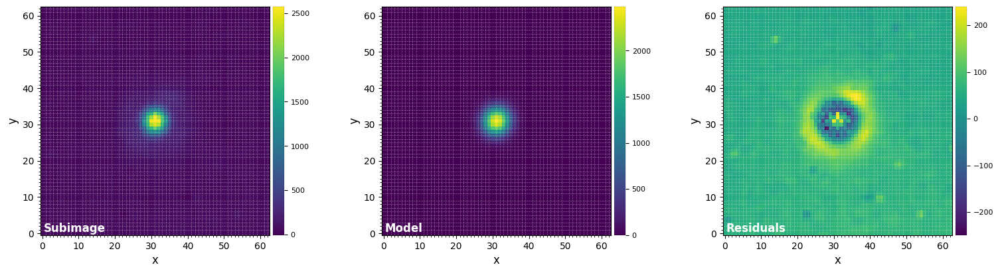

FWHM_y = 6.339064269473173
FWHM_x = 6.006039198564034 

centroid y = 30.950780025483542
centroid x = 31.05268261865655
centroid y subim = 30.950780025483542
centroid x subim = 31.05268261865655 

amplitude = 2479.426469602535
theta = -25.77229772171515


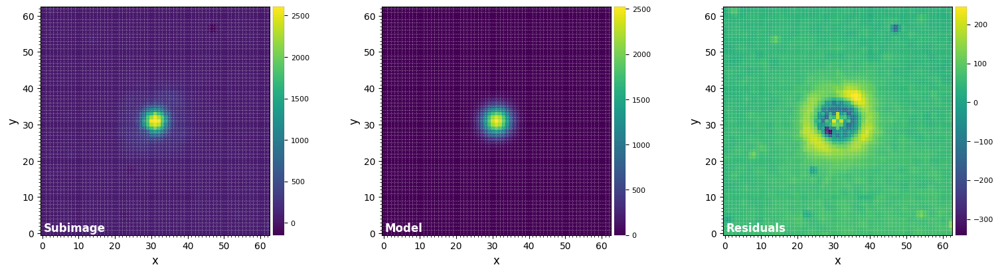

FWHM_y = 6.2521563359140515
FWHM_x = 6.097356694417138 

centroid y = 30.972915964964674
centroid x = 31.06082835995522
centroid y subim = 30.972915964964674
centroid x subim = 31.06082835995522 

amplitude = 2527.066308423454
theta = -21.812414024348396


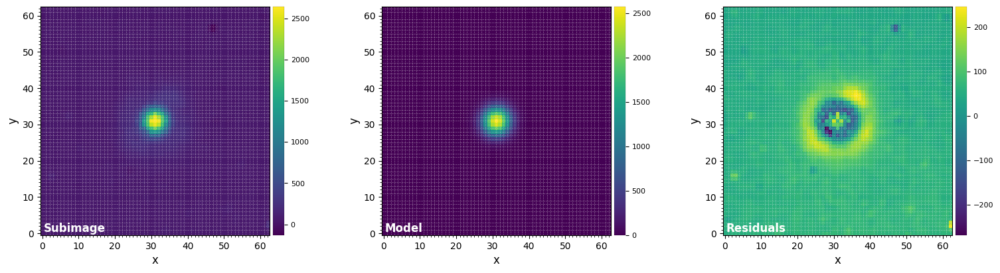

FWHM_y = 6.141562308460642
FWHM_x = 6.330833411077855 

centroid y = 30.950451038145037
centroid x = 31.037304362586124
centroid y subim = 30.950451038145037
centroid x subim = 31.037304362586124 

amplitude = 2577.7786839583086
theta = -117.42894368744399


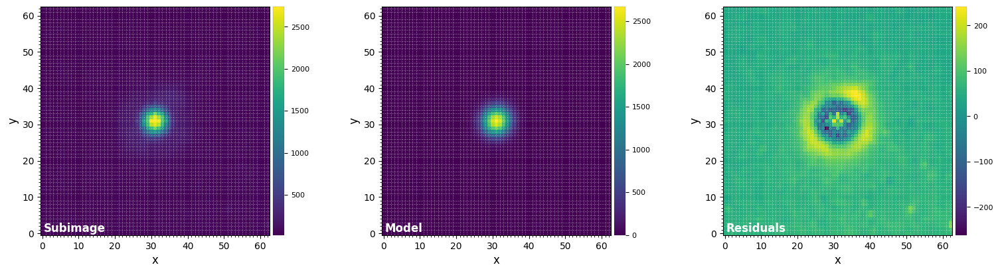

FWHM_y = 6.162598097188802
FWHM_x = 6.42023922067202 

centroid y = 30.946562012542724
centroid x = 31.018853144262906
centroid y subim = 30.946562012542724
centroid x subim = 31.018853144262906 

amplitude = 2674.3764962285936
theta = 420.2617582498118


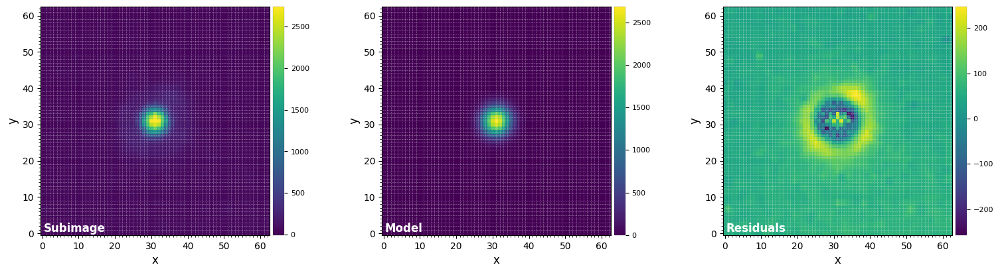

FWHM_y = 6.169156434113273
FWHM_x = 6.386383962671222 

centroid y = 30.961121621041503
centroid x = 30.992012879501615
centroid y subim = 30.961121621041503
centroid x subim = 30.992012879501615 

amplitude = 2686.0335893943384
theta = -112.56859476092643


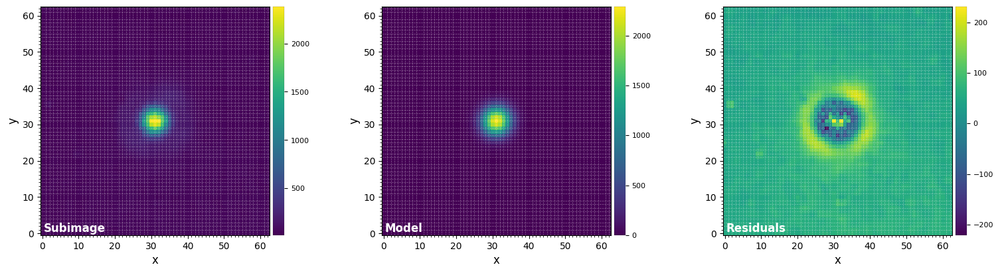

FWHM_y = 6.353978415141805
FWHM_x = 6.499000586146892 

centroid y = 30.986129812467137
centroid x = 31.004149337780635
centroid y subim = 30.986129812467137
centroid x subim = 31.004149337780635 

amplitude = 2292.729907008748
theta = 55.49688479914074


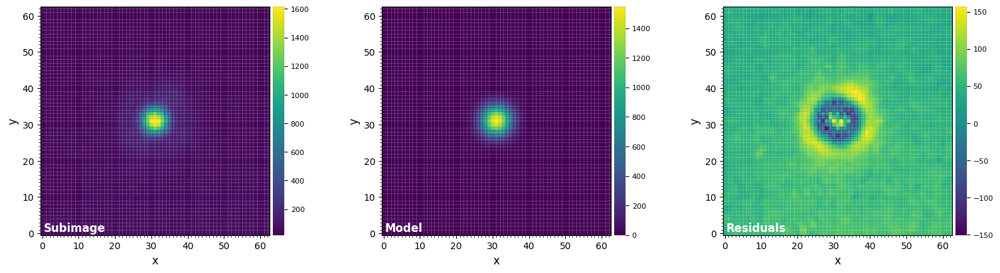

FWHM_y = 6.82169946874245
FWHM_x = 6.652707580846448 

centroid y = 31.082450806990927
centroid x = 31.005779875479682
centroid y subim = 31.082450806990927
centroid x subim = 31.005779875479682 

amplitude = 1547.0773926071454
theta = -37.72839923079208


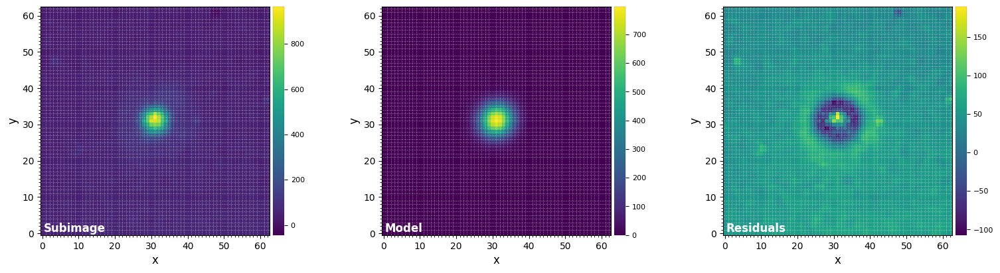

FWHM_y = 7.622013349554279
FWHM_x = 7.263191064413006 

centroid y = 31.214888719293135
centroid x = 31.02995943917245
centroid y subim = 31.214888719293135
centroid x subim = 31.02995943917245 

amplitude = 799.116186416396
theta = -40.4961075188366


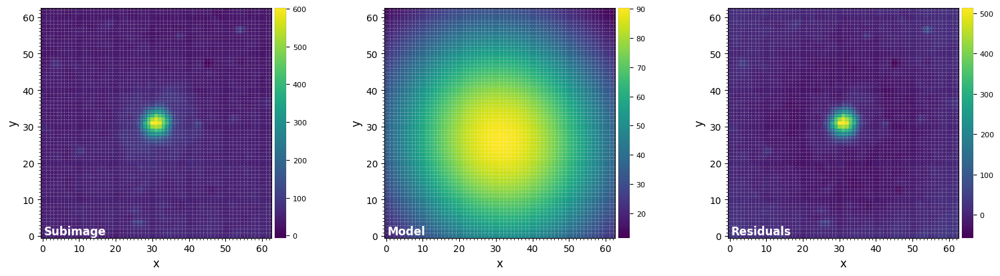

FWHM_y = 58.47491614443595
FWHM_x = 54.10569587238597 

centroid y = 26.26233205903197
centroid x = 31.35130438091548
centroid y subim = 26.26233205903197
centroid x subim = 31.35130438091548 

amplitude = 90.32149945161262
theta = 26.33074753357387


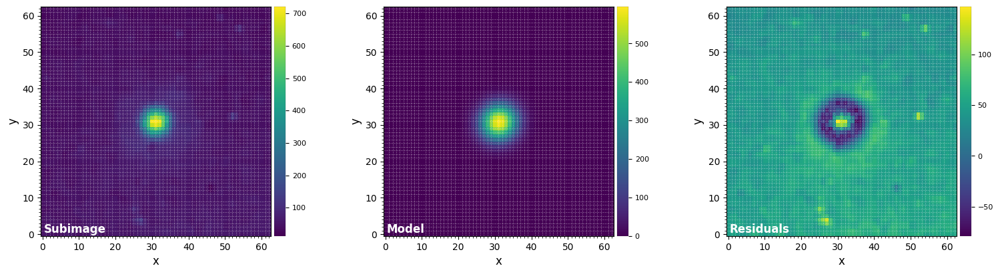

FWHM_y = 7.886113843060749
FWHM_x = 8.250699688146874 

centroid y = 30.764770401239495
centroid x = 31.092304079038055
centroid y subim = 30.764770401239495
centroid x subim = 31.092304079038055 

amplitude = 597.6701150284346
theta = 42.89796099431881


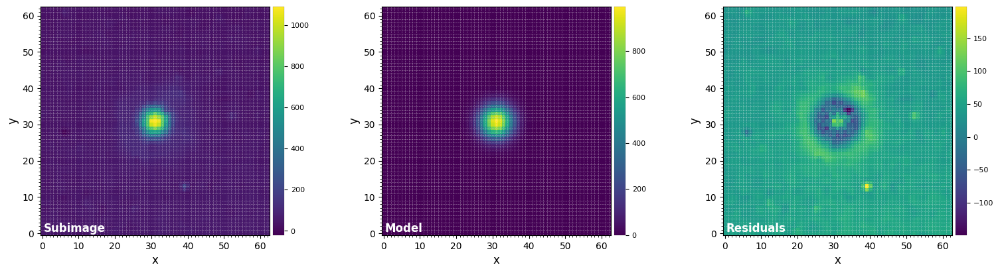

FWHM_y = 7.223153786811936
FWHM_x = 7.093443128314921 

centroid y = 30.787651919284663
centroid x = 31.0176870468265
centroid y subim = 30.787651919284663
centroid x subim = 31.0176870468265 

amplitude = 996.2057276768348
theta = -19.319072181528448


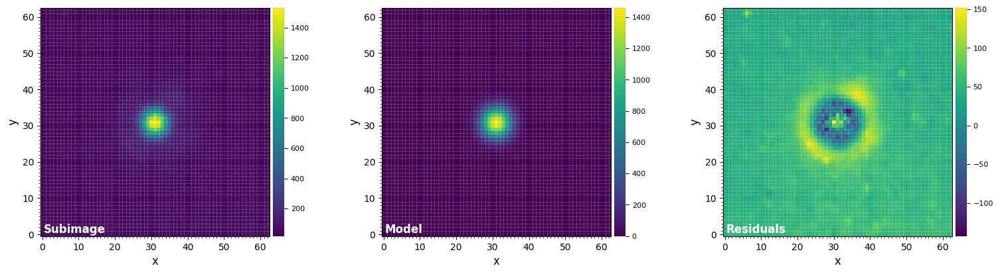

FWHM_y = 6.921864594724662
FWHM_x = 6.760880360797927 

centroid y = 30.820212531725705
centroid x = 30.994372196917038
centroid y subim = 30.820212531725705
centroid x subim = 30.994372196917038 

amplitude = 1462.3082477181445
theta = -6.092071105941251


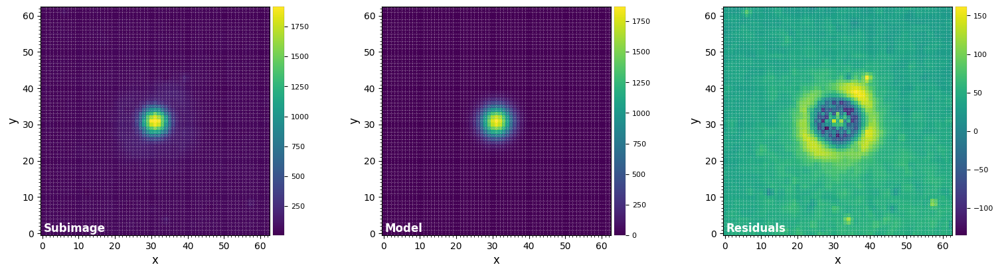

FWHM_y = 6.816072171269081
FWHM_x = 6.6691858333367655 

centroid y = 30.82932071306381
centroid x = 31.004825798335077
centroid y subim = 30.82932071306381
centroid x subim = 31.004825798335077 

amplitude = 1874.8765496027454
theta = -10.474687089583734


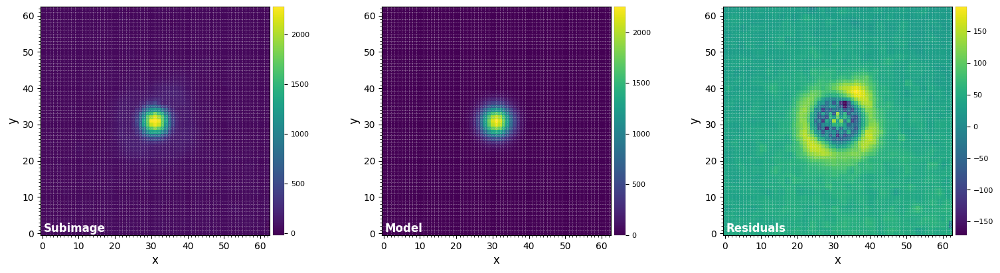

FWHM_y = 6.710245677921731
FWHM_x = 6.624230634397002 

centroid y = 30.831818777619965
centroid x = 30.994732672649764
centroid y subim = 30.831818777619965
centroid x subim = 30.994732672649764 

amplitude = 2257.0629146220695
theta = 1.0796058468182905


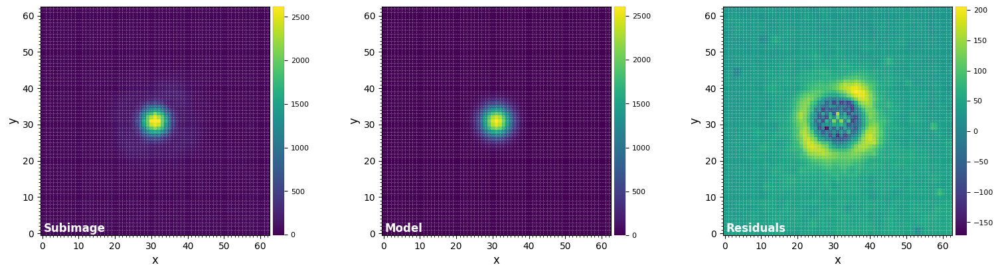

FWHM_y = 6.731674442922951
FWHM_x = 6.5837851495488815 

centroid y = 30.865289768001563
centroid x = 31.007920718776433
centroid y subim = 30.865289768001563
centroid x subim = 31.007920718776433 

amplitude = 2611.2866650562974
theta = -5.209670635137322


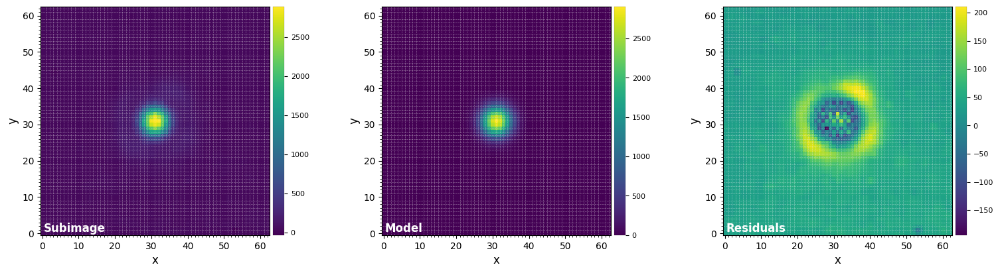

FWHM_y = 6.745158073421545
FWHM_x = 6.588593316475375 

centroid y = 30.893731822699717
centroid x = 31.014594005780097
centroid y subim = 30.893731822699717
centroid x subim = 31.014594005780097 

amplitude = 2908.6067263745094
theta = -10.053377844475204


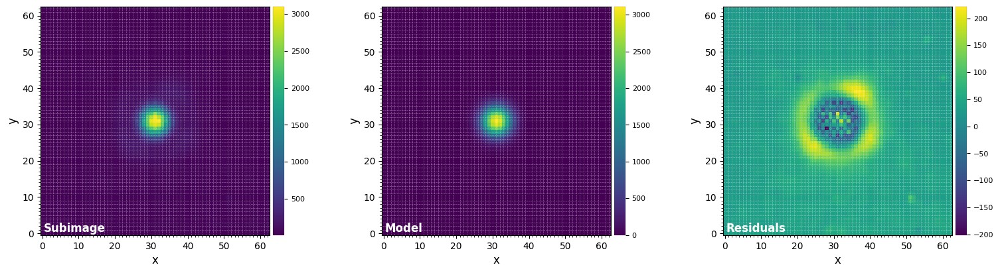

FWHM_y = 6.7406655561784365
FWHM_x = 6.600496406050832 

centroid y = 30.925968597576336
centroid x = 31.023928342805394
centroid y subim = 30.925968597576336
centroid x subim = 31.023928342805394 

amplitude = 3112.497007425281
theta = -10.924652579532552


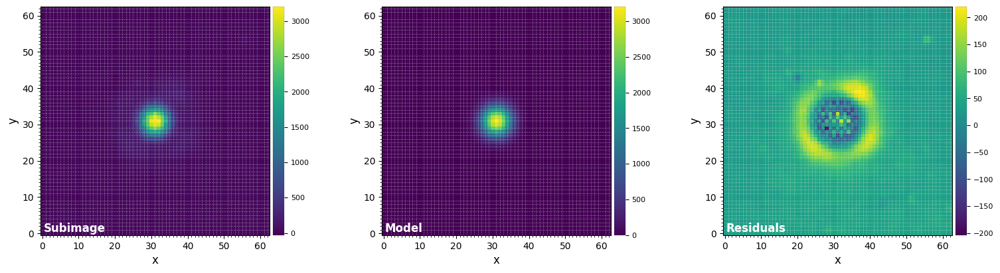

FWHM_y = 6.768341344823729
FWHM_x = 6.617862355979282 

centroid y = 30.932147814542898
centroid x = 31.035871007916167
centroid y subim = 30.932147814542898
centroid x subim = 31.035871007916167 

amplitude = 3208.640719315391
theta = -11.445808461928994


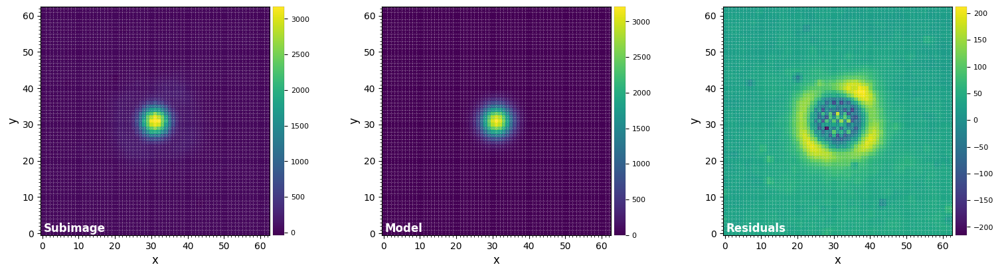

FWHM_y = 6.830607191539974
FWHM_x = 6.6545458771769255 

centroid y = 30.92716483478671
centroid x = 31.03817482111276
centroid y subim = 30.92716483478671
centroid x subim = 31.03817482111276 

amplitude = 3211.328765569525
theta = -9.536120352298077


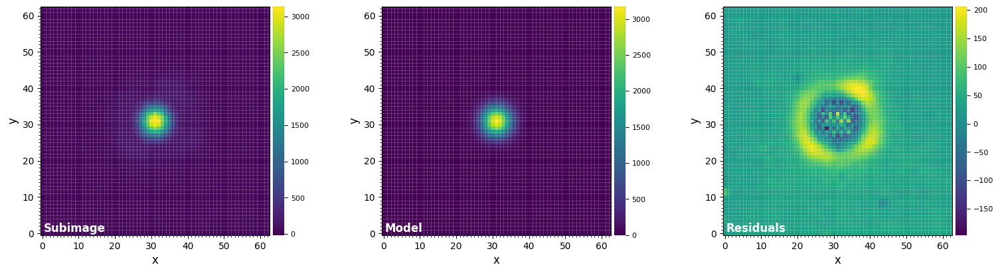

FWHM_y = 6.858086837467954
FWHM_x = 6.717140354931551 

centroid y = 30.930403728726073
centroid x = 31.04770019112508
centroid y subim = 30.930403728726073
centroid x subim = 31.04770019112508 

amplitude = 3174.2717075579226
theta = -4.180761229304071


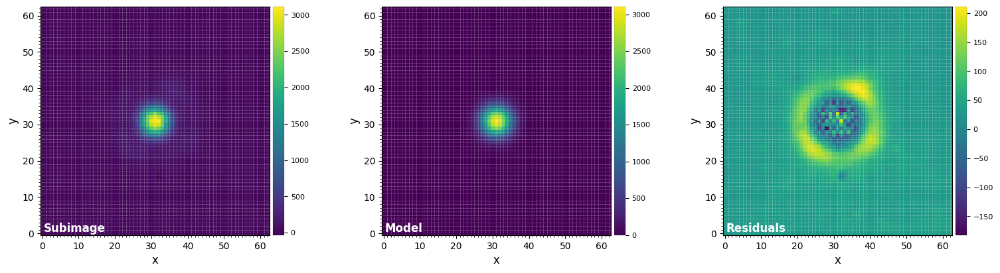

FWHM_y = 6.90657099167757
FWHM_x = 6.758898517422927 

centroid y = 30.910177126905108
centroid x = 31.036778342946455
centroid y subim = 30.910177126905108
centroid x subim = 31.036778342946455 

amplitude = 3109.691301071098
theta = 1.977524898343984


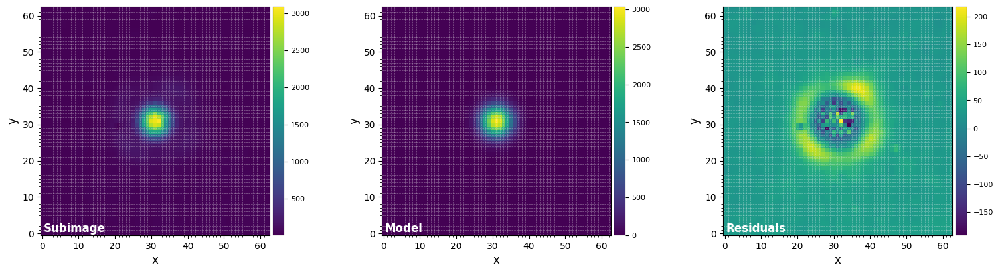

FWHM_y = 6.9483041252138635
FWHM_x = 6.789054464648142 

centroid y = 30.922822272979264
centroid x = 31.0243703495482
centroid y subim = 30.922822272979264
centroid x subim = 31.0243703495482 

amplitude = 3038.7940292094468
theta = -4.688615119638496


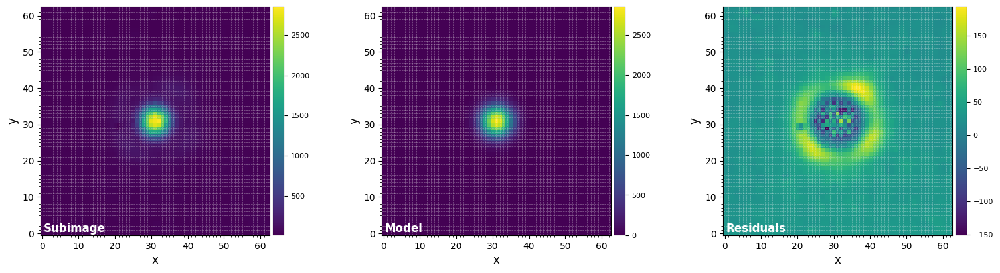

FWHM_y = 6.9575825632604476
FWHM_x = 6.83954142864951 

centroid y = 30.953553908294996
centroid x = 31.05660973700785
centroid y subim = 30.953553908294996
centroid x subim = 31.05660973700785 

amplitude = 2858.139156243566
theta = -9.646178202344176


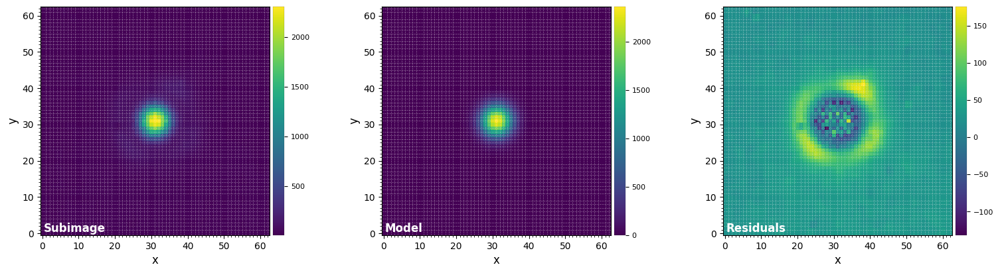

FWHM_y = 7.090640088241212
FWHM_x = 6.89299762993233 

centroid y = 31.018843780011874
centroid x = 31.07140443215051
centroid y subim = 31.018843780011874
centroid x subim = 31.07140443215051 

amplitude = 2362.3730042619495
theta = -10.665265133173088
Mean FWHM per channel: 
[ 5.92   5.718  5.654  5.646  5.631  5.694  5.805  5.874  5.857  5.957
  6.07   6.117  6.072  6.12   6.139  6.173  6.175  6.236  6.291  6.278
  6.426  6.737  7.443 56.29   8.068  7.158  6.841  6.743  6.667  6.658
  6.667  6.671  6.693  6.743  6.788  6.833  6.869  6.899  6.992]
Flux in 1xFWHM aperture: 
[ 16959.426  24857.461  29595.235  31947.152  33362.613  36149.656
  38979.712  41141.761  39943.536  36603.674  36044.983  40285.04
  45174.094  48495.287  51099.407  53645.885  54821.967  57025.362
  60142.679  60139.651  53828.472  40190.496  25442.499 150902.3
  22317.924  29279.5    39070.097  48515.698  56972.705  65653.038
  73289.034  78481.13   81447.525  82795.094  82942.014  82266.78
  81101.743  77172.7

In [10]:
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf[:,0], fwhm='fit', full_output=True, debug=True)

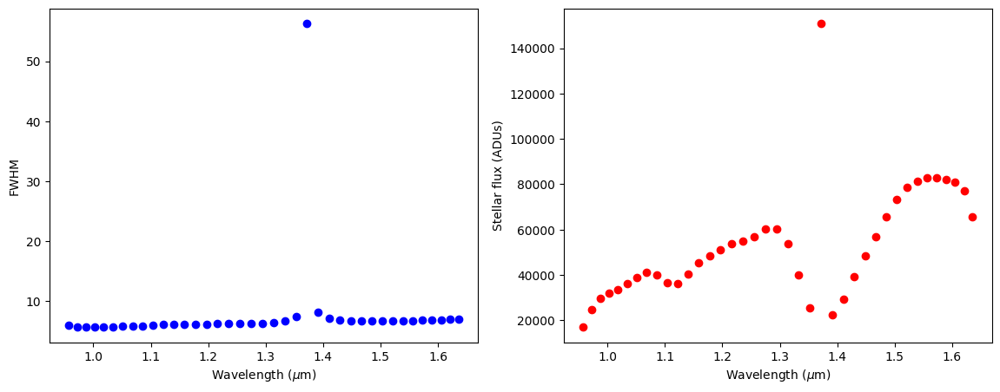

In [11]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[63, 63, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
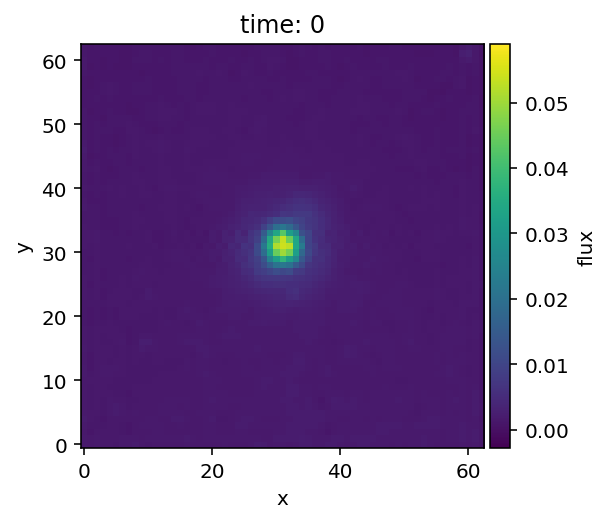

In [12]:
plot_cubes(psfn, grid=True)

## Post-processing of IFS data

### Optimal scaling factor

In [13]:
th_scal = lbda[-1]/lbda
th_scal

array([1.7083944, 1.6831094, 1.6576661, 1.6321594, 1.6066693, 1.5812904,
       1.5560788, 1.5311139, 1.5064236, 1.4820738, 1.4581087, 1.4345539,
       1.4114556, 1.38883  , 1.3667127, 1.3451117, 1.3240438, 1.3035111,
       1.2835453, 1.2641329, 1.2452896, 1.2270088, 1.2092929, 1.1921507,
       1.1755639, 1.1595472, 1.1440812, 1.1291704, 1.1148103, 1.1009887,
       1.087701 , 1.0749491, 1.0627136, 1.0510033, 1.0397995, 1.0291036,
       1.0189114, 1.0092114, 1.       ], dtype=float32)

In [14]:
mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st,
                                           mask=mask, nfp=2, fm="stddev")

In [15]:
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in range(cube.shape[1]):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

In [16]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

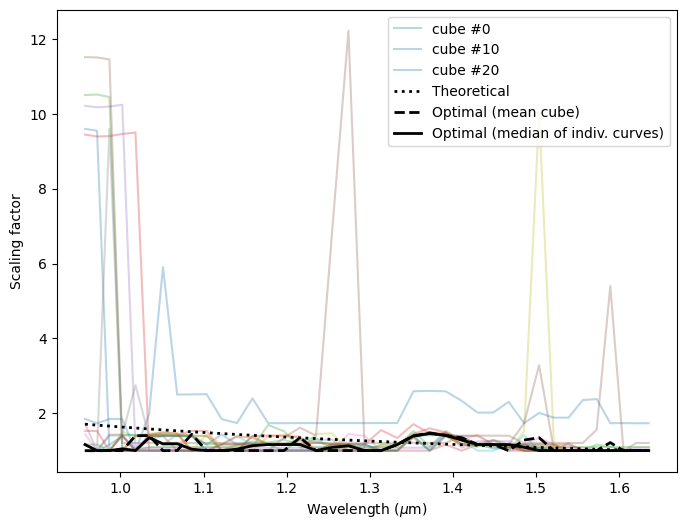

In [17]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

In [18]:
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[290, 290, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
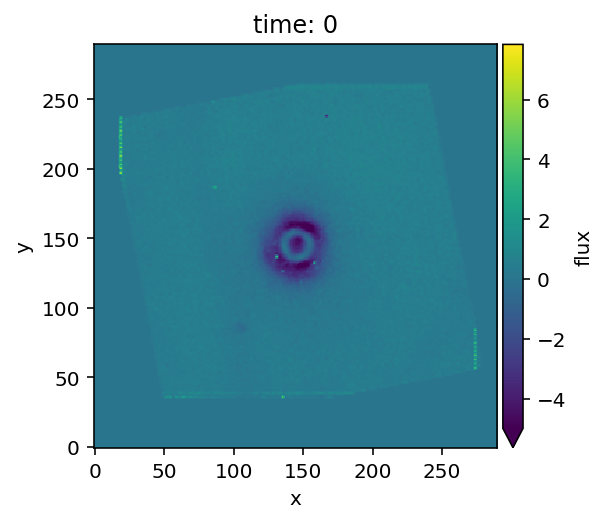

In [19]:
plot_cubes(res_cube_test_opt, vmin=-5)

### median-SDI

In [20]:
mask_px = int(0.1/plsc)

med_SDI = median_sub(cube, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:47:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:02:19.257792
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:02:31.941178
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [21]:
med_SDI_opt = median_sub(cube, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:49:51
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:02:23.549279
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:02:35.963077
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


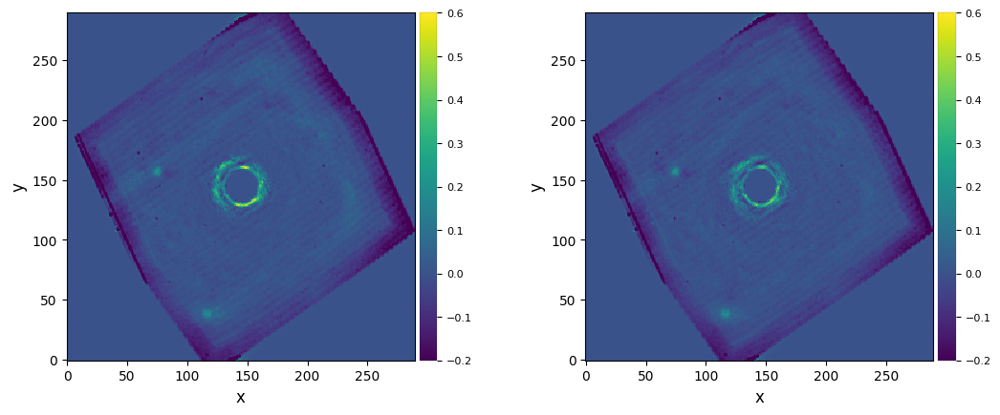

In [22]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), vmin=-0.2, vmax=0.6)

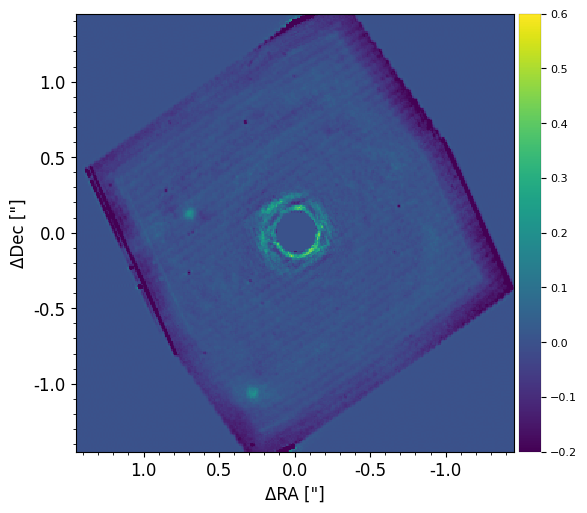

In [40]:
plot_frames(med_SDI_opt, vmin=-0.2, vmax=0.6, ang_scale=True)

### PCA-SDI

#### Full-frame PCA

In [23]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)

pca_sdi = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None),
              adimsdi='double', crop_ifs=False, imlib='opencv',
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:52:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 115.501 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:02:05.761907
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:02:05.925794
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


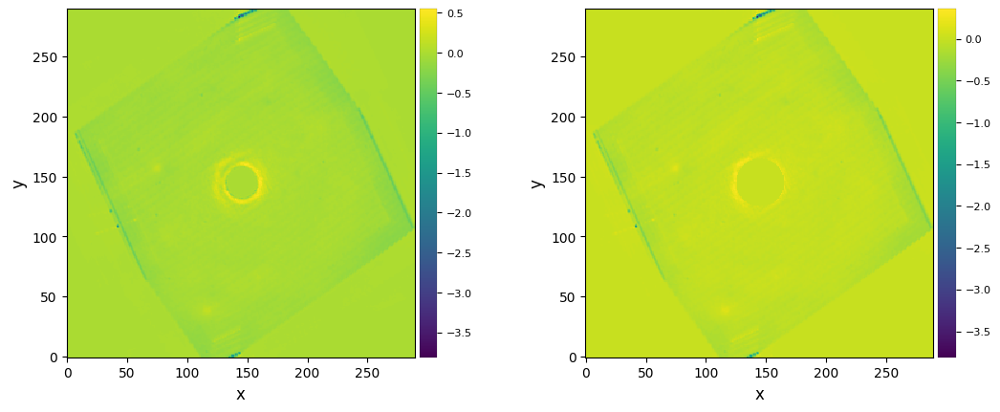

In [24]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)))

#### Annular PCA

In [29]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube, derot_angles, scale_list=opt_scal_med,
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.1, 0.3), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 16:00:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 17, mean FWHM = 8.000


Running time:  0:06:31.650648
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Skipping the second PCA subtraction


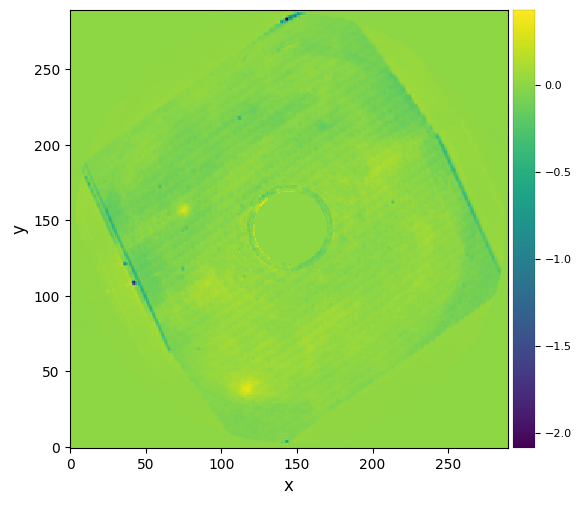

In [45]:
plot_frames(mask_circle(pca_sdi_ann, int(0.18/plsc)))

### median-ASDI

In [46]:
mask_px = int(0.1/plsc)

med_ASDI = median_sub(cube, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 16:45:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:02:21.778246
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:02:34.502354
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


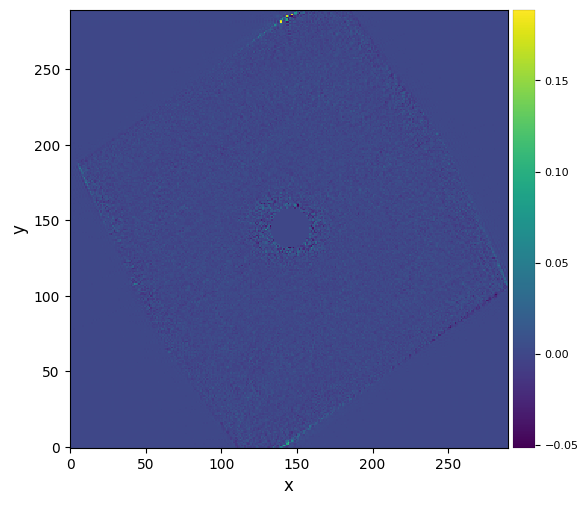

In [47]:
%matplotlib inline
plot_frames(med_ASDI)

### PCA-ASDI

#### Full-frame PCA-ASDI (single step)

In [48]:
ncomp = 6
pca_asdi = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                adimsdi='single', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 16:48:10
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 112.689 GB
Rescaling the spectral channels to align the speckles
Running time:  0:01:08.356486
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
936 total frames
Performing single-pass PCA
Done vectorizing the frames. Matrix shape: (936, 178084)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:50.457709
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels
De-rotating and combining residuals
Running time:  0:02:40.168833
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


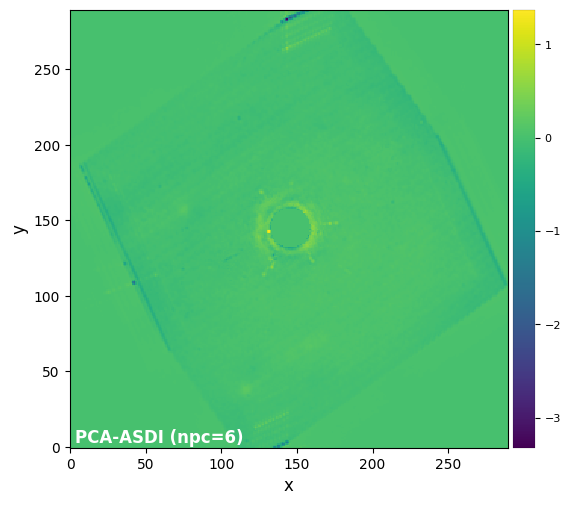

In [49]:
plot_frames(pca_asdi, label='PCA-ASDI (npc={:.0f})'.format(ncomp),
            dpi=100, colorbar=True)

#### Full-frame PCA-ASDI (double step)

In [50]:
ncomp = (1,1)
pca_asdi_2s = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 16:51:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 112.617 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:02:06.777093
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:02:19.388047
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


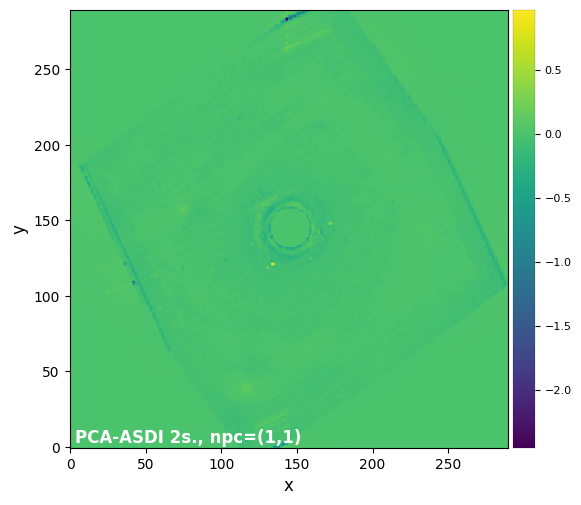

In [51]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True)

#### Annular PCA-ASDI (double step)

In [53]:
ncomp = (1,1)
pca_ann = pca_annular(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm),
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 19:33:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 17, mean FWHM = 8.000


Running time:  0:06:53.930965
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
24 ADI frames
Second PCA subtraction exploiting the angular variability
N annuli = 17, FWHM = 8.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.72    Ann center:  17    N segments: 1 


RuntimeError: Too few frames left in the PCA library. Accepted indices length (0) less than 2. Try decreasing either delta_rot or min_frames_lib.

In [ ]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True)

### PCA-ADI for all spectral channels

In [54]:
mask_px = int(0.08/plsc)

In [55]:
ncomp_ff = 6
pca_adi_mean = pca(cube, derot_angles, ncomp=ncomp_ff, adimsdi='single', mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 19:55:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 113.501 GB
Done vectorizing the frames. Matrix shape: (24, 84100)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.083523
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:12.258739
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (24, 84100)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:12.348471
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:24.761319
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: 

In [56]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube, derot_angles, ncomp=ncomp_ann, radius_int=mask_px,
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 20:03:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 8, FWHM = 7.682
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.98    Ann center:  18    N segments: 1 


RuntimeError: Too few frames left in the PCA library. Accepted indices length (0) less than 2. Try decreasing either delta_rot or min_frames_lib.

In [ ]:
plot_frames((pca_adi_mean, pca_adi_ann_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann)),
            dpi=100, colorbar=True)

## Plotting the disk structures

In [57]:
from astropy.visualization import (AsinhStretch, LinearStretch, LogStretch, ImageNormalize)
from matplotlib.patches import Ellipse
import matplotlib.gridspec as gridspec
import scipy.ndimage
from matplotlib.offsetbox import AnchoredOffsetbox, AuxTransformBox, DrawingArea, TextArea, VPacker
from matplotlib.patches import Rectangle

In [58]:
fig = plt.figure(figsize=(10, 9))
gs  = gridspec.GridSpec(2, 2, figure = fig, width_ratios=(1, 1), height_ratios=(1, 1))
norm = ImageNormalize(vmin=-5,vmax=5, stretch=LinearStretch())
fig_size = 1.2

<Figure size 1000x900 with 0 Axes>

In [74]:
aoff, doff = 0,0 #-0.89,0.9
RA_CO  = -12.25e-3 * (np.arange(cubee[0].header['NAXIS1'])-(145))
DEC_CO = 12.25e-3 * (np.arange(cubee[0].header['NAXIS2'])-(145))
ext_CO = (np.max(RA_CO)-aoff, np.min(RA_CO)-aoff, np.min(DEC_CO)-doff, np.max(DEC_CO)-doff)

In [60]:
def mk_ellipse(x0,y0,R,incl,PA, npts=200):
    phi = 2.*np.pi*np.arange(npts)/(npts-1.)
    incl_rad = incl * np.pi/180.
    PA_rad = (PA) * np.pi/180.
    xell = R*np.cos(phi)*np.cos(incl_rad)
    yell = R*np.sin(phi)
    xrot = ( (xell)*np.cos(PA_rad) + (yell)*np.sin(PA_rad) ) + x0
    yrot = (-(xell)*np.sin(PA_rad) + (yell)*np.cos(PA_rad) ) + y0
    return [xrot, yrot]

In [61]:
#gap radius, offsets,inclination and position angle
g1 = 309e-3
x0g1, y0g1 = -1.0e-3, 28.9e-3
ig1 = 17.02
PAg1 = 176.2

g2 = 133e-3
x0g2, y0g2 = -4.4e-3, 23.1e-3
ig2 = 24.1
PAg2 = 164.3

#ring radius, offsets,inclination and position angle
r1 = 393e-3
x0r1, y0r1 = -1.4e-3, 24e-3 # consider this as outer disk offsets
ir1 = 17.2
PAr1 = 164

r2 = 247.3e-3
x0r2, y0r2 = -6.3e-3, 21.5e-3 # consider this as outer disk offsets
ir2 = 18.9
PAr2 = 169

In [62]:
#gap ellipse
xg1, yg1 = mk_ellipse(x0g1,y0g1,g1,ig1,PAg1,5000)
xg2, yg2 = mk_ellipse(x0g2,y0g2,g2,ig2,PAg2,5000)
xr1, yr1 = mk_ellipse(x0r1,y0r1,r1,ir1,PAr1,500)
xr2, yr2 = mk_ellipse(x0r2,y0r2,r2,ir2,PAr2,500)

In [63]:
# PA and center for outer disk
PA = PAr1*np.pi/180.
x0 = x0r1
y0 = y0r1
xPa = [x0 + 2.5 * np.sin(PA) -x0r1, x0 - 2.5 * np.sin(PA)-x0r1]
yPa = [y0 + 2.5 * np.cos(PA) -y0r1, y0 - 2.5 * np.cos(PA)-y0r1]
xPa2 = [x0 - 2.5 * np.cos(PA) -x0r1 , x0 + 2.5 * np.cos(PA) - x0r1]
yPa2 = [y0 + 2.5 * np.sin(PA) -y0r1, y0 - 2.5 * np.sin(PA)-y0r1]

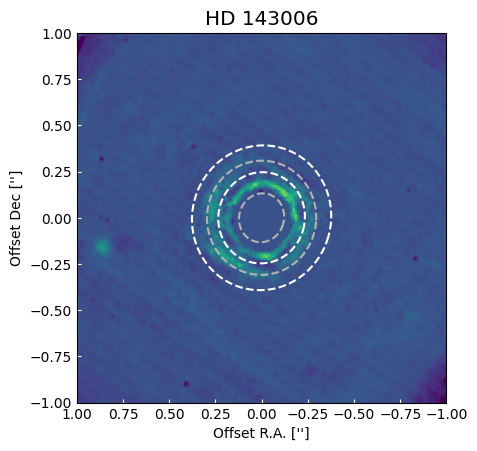

In [83]:
ax1 = fig.add_subplot(gs[0,0])
masked_array = np.ma.array(med_SDI_opt, mask=np.isnan(med_SDI_opt))
im1 = plt.imshow(masked_array, extent=ext_CO, vmin=-0.2, vmax=0.6)
plt.xlim([1,-1])
plt.ylim([-1,1])
plt.xlabel("Offset R.A. ['']")
plt.ylabel("Offset Dec ['']")
plt.tick_params('both', length=3, direction='in', which='major', color='white',labelcolor='k')
plt.title('HD 143006', fontsize='x-large')
#plt.yticks([-1.0,- 0.5, 0.0, 0.5, 1.0])
#plt.xticks([1.5, 1.0, 0.5, 0.0, -0.5, -1.0, -1.5])
plt.plot(xr1-x0r1,yr1-y0r1,'w--')
plt.plot(xg1-x0g1,yg1-y0g1,'--', color='0.7')
plt.plot(xr2-x0r2,yr2-y0r2,'w--')
plt.plot(xg2-x0g2,yg2-y0g2,'--', color='0.7')